In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
import folium
from folium import plugins
from folium.plugins import MarkerCluster
from geopy.distance import geodesic
from geopy.geocoders import Nominatim
from folium.plugins import HeatMap
import tabulate as tabulate
import geopandas as gpd
import requests
from geopy.distance import great_circle

In [3]:
bike_master = pd.read_csv('bike_full.csv', dtype={5: str, 7: str})  # Convert both columns to strings

In [4]:
# before_cleaning = bike_master.memory_usage(deep=True).sum() / 1024 ** 2
# print(f"Memory usage before cleaning: {before_cleaning:.2f} MB")

In [5]:
bike_master.isnull().sum()

ride_id                    0
rideable_type              0
started_at                 0
ended_at                   0
start_station_name    742776
start_station_id      742776
end_station_name      811282
end_station_id        811282
start_lat                  2
start_lng                  2
end_lat                16765
end_lng                16765
member_casual              0
dtype: int64

In [6]:
bike_master_clean = bike_master.copy()

# Convert datetime columns
bike_master_clean['started_at'] = pd.to_datetime(bike_master_clean['started_at'])
bike_master_clean['ended_at'] = pd.to_datetime(bike_master_clean['ended_at'])

# Convert category columns
category_columns = ['rideable_type', 'start_station_name', 'end_station_name', 'member_casual']
for col in category_columns:
    bike_master_clean[col] = bike_master_clean[col].astype('category')

# Convert string columns (IDs)
string_columns = ['ride_id', 'start_station_id', 'end_station_id']
for col in string_columns:
    bike_master_clean[col] = bike_master_clean[col].astype('string')



In [7]:
after_cleaning = bike_master_clean.memory_usage(deep=True).sum() / 1024 ** 2
print(f"Memory usage after cleaning: {after_cleaning:.2f} MB")

Memory usage after cleaning: 2355.93 MB


In [8]:
bike_master_clean.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,5CB9DFCECF79AF84,classic_bike,2021-01-01 00:08:33,2021-01-01 00:33:53,Maine Ave & 9th St SW,31646.0,Rosslyn Metro / Wilson Blvd & Ft Myer Dr,31015.0,38.880440,-77.025236,38.894600,-77.072305,member
1,629E059504606547,electric_bike,2021-01-01 00:13:43,2021-01-01 00:29:34,10th & U St NW,31111.0,NaN,<NA>,38.917193,-77.025894,38.960000,-77.020000,casual
2,E74069873161EE33,electric_bike,2021-01-01 00:14:32,2021-01-01 00:28:45,17th & Corcoran St NW,31214.0,14th & Belmont St NW,31119.0,38.912138,-77.038568,38.920870,-77.031691,member
3,91F95E512CABC46A,classic_bike,2021-01-01 00:15:45,2021-01-01 00:21:20,Wilson Blvd. & N. Vermont St.,31926.0,Wilson Blvd. & N. Vermont St.,31926.0,38.879477,-77.114563,38.879477,-77.114563,member
4,DA46A05139C0EA2F,classic_bike,2021-01-01 00:17:46,2021-01-01 00:21:00,11th & Park Rd NW,31651.0,14th & Newton St NW,31649.0,38.931322,-77.028247,38.931991,-77.032956,member


In [9]:
bike_master_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10693997 entries, 0 to 10693996
Data columns (total 13 columns):
 #   Column              Dtype         
---  ------              -----         
 0   ride_id             string        
 1   rideable_type       category      
 2   started_at          datetime64[ns]
 3   ended_at            datetime64[ns]
 4   start_station_name  category      
 5   start_station_id    string        
 6   end_station_name    category      
 7   end_station_id      string        
 8   start_lat           float64       
 9   start_lng           float64       
 10  end_lat             float64       
 11  end_lng             float64       
 12  member_casual       category      
dtypes: category(4), datetime64[ns](2), float64(4), string(3)
memory usage: 795.6 MB


In [10]:
bike_master_clean.isnull().sum()

ride_id                    0
rideable_type              0
started_at                 0
ended_at                   0
start_station_name    742776
start_station_id      742776
end_station_name      811282
end_station_id        811282
start_lat                  2
start_lng                  2
end_lat                16765
end_lng                16765
member_casual              0
dtype: int64

In [11]:
bike_master_clean[['start_station_name', 'end_station_name', 'start_station_id', 'end_station_id','start_lat']].nunique()

start_station_name       860
end_station_name         865
start_station_id        1321
end_station_id          1338
start_lat             570110
dtype: int64

In [12]:
# # Find and export matching stations
# matching_station = bike_master_clean[
#   (bike_master_clean['start_lat'].round(2) == 38.93) & 
#   (bike_master_clean['start_lng'].round(2) == -77.02)
# ][['start_station_name', 'start_lat', 'start_lng']].dropna().drop_duplicates()

# matching_station.to_csv('matching_stations1.csv', index=False)

In [13]:
bike_master_clean.isnull().sum()

ride_id                    0
rideable_type              0
started_at                 0
ended_at                   0
start_station_name    742776
start_station_id      742776
end_station_name      811282
end_station_id        811282
start_lat                  2
start_lng                  2
end_lat                16765
end_lng                16765
member_casual              0
dtype: int64

In [14]:
#create a new column for month year
bike_master_clean['month_year'] = bike_master_clean['started_at'].dt.to_period('M')

#create a new column for year
bike_master_clean['year'] = bike_master_clean['started_at'].dt.year

#create a new dataframe for the month Jan 2023 to december 2023
bike_master_clean_2023 = bike_master_clean[(bike_master_clean['year'] == 2023)]

row_count = len(bike_master_clean_2023)
print(f"Number of rows in the dataset: {row_count}")



Number of rows in the dataset: 4467334


In [15]:
#find missing null values
bike_master_clean_2023.isnull().sum()

#drop missing values
bike_master_clean_2023 = bike_master_clean_2023.dropna()


In [16]:
#get the top 10 stations with the highest number of trips using the start station name and ride id
top_stations = (
    bike_master_clean_2023
    .groupby('start_station_name',observed=False)
    .agg(trip_count=('ride_id', 'count'))
    .nlargest(10, 'trip_count')
    .reset_index()
)

top_stations

,start_station_name,trip_count
0,Columbus Circle / Union Station,45056
1,New Hampshire Ave & T St NW,39841
2,15th & P St NW,35907
3,5th & K St NW,33002
4,Eastern Market Metro / Pennsylvania Ave & 8th ...,32597
5,Lincoln Memorial,32498
6,1st & M St NE,32063
7,14th & V St NW,31379
8,Jefferson Dr & 14th St SW,30656
9,Massachusetts Ave & Dupont Circle NW,29871


In [17]:
#get the top 10 end stations with the highest number of trips using the end station name and ride id
end_stations = (
    bike_master_clean_2023
    .groupby('end_station_name',observed=False)
    .agg(trip_count=('ride_id', 'count'))
    .nlargest(10, 'trip_count')
    .reset_index()
)

end_stations

,end_station_name,trip_count
0,Columbus Circle / Union Station,45194
1,New Hampshire Ave & T St NW,38952
2,15th & P St NW,36003
3,5th & K St NW,33624
4,Lincoln Memorial,32721
5,Eastern Market Metro / Pennsylvania Ave & 8th ...,32689
6,1st & M St NE,32526
7,Jefferson Dr & 14th St SW,31729
8,Massachusetts Ave & Dupont Circle NW,30680
9,14th & V St NW,29833


In [18]:
popular_stations = pd.concat([top_stations, end_stations], axis=1)
popular_stations

,start_station_name,trip_count,end_station_name,trip_count
0,Columbus Circle / Union Station,45056,Columbus Circle / Union Station,45194
1,New Hampshire Ave & T St NW,39841,New Hampshire Ave & T St NW,38952
2,15th & P St NW,35907,15th & P St NW,36003
3,5th & K St NW,33002,5th & K St NW,33624
4,Eastern Market Metro / Pennsylvania Ave & 8th ...,32597,Lincoln Memorial,32721
5,Lincoln Memorial,32498,Eastern Market Metro / Pennsylvania Ave & 8th ...,32689
6,1st & M St NE,32063,1st & M St NE,32526
7,14th & V St NW,31379,Jefferson Dr & 14th St SW,31729
8,Jefferson Dr & 14th St SW,30656,Massachusetts Ave & Dupont Circle NW,30680
9,Massachusetts Ave & Dupont Circle NW,29871,14th & V St NW,29833


In [19]:
# Filter for the specific start station name
station_name = 'Columbus Circle / Union Station'
df_filtered = bike_master_clean_2023[bike_master_clean_2023['start_station_name'] == station_name]

#count the number of entries for the specific station
df_filtered_count = df_filtered.shape[0]

# Count unique start latitude and longitude values
num_unique_lat_lng = df_filtered[['start_lat', 'start_lng']].drop_duplicates().shape[0]

#Unique start latitude and longitude values
unique_lat_lng = df_filtered[['start_lat', 'start_lng']].drop_duplicates()
unique_lat_lng



,start_lat,start_lng
6226798,38.896960,-77.004930
6228246,38.897096,-77.005045
6228739,38.897175,-77.005028
6233624,38.897007,-77.004727
6236519,38.896988,-77.004778
...,...,...
10691963,38.897144,-77.004901
10692966,38.897147,-77.004928
10693043,38.897062,-77.004938
10693123,38.897085,-77.004961


In [20]:
bike_master_clean.groupby(['member_casual', 'rideable_type'], observed=False)['end_station_id'].apply(lambda x: x.isnull().sum())

member_casual  rideable_type
casual         classic_bike      11554
               docked_bike        5136
               electric_bike    303090
member         classic_bike       8341
               docked_bike           0
               electric_bike    483161
Name: end_station_id, dtype: int64

In [21]:
#Count of trip by member type and rideable type by ride id
member_rideable = (
    bike_master_clean
    .groupby(['member_casual', 'rideable_type'], observed=False)
    .agg(trip_count=('ride_id', 'count'))
    .reset_index()
)

member_rideable

,member_casual,rideable_type,trip_count
0,casual,classic_bike,2702259
1,casual,docked_bike,539470
2,casual,electric_bike,959474
3,member,classic_bike,5008113
4,member,docked_bike,4
5,member,electric_bike,1484677


In [22]:
#calculating the num  of trips by member type
trip_counts = bike_master_clean['member_casual'].value_counts()

#calculating the percentage of trips by member type
trip_percent = (trip_counts / trip_counts.sum()) * 100

trip_percent

member_casual
member    60.71438
casual    39.28562
Name: count, dtype: float64

In [23]:
# Count of trip by member type and rideable type by ride id in percentage
member_rideable['percentage'] = member_rideable['trip_count'] / member_rideable.groupby('member_casual', observed=False)['trip_count'].transform('sum') * 100
member_rideable

,member_casual,rideable_type,trip_count,percentage
0,casual,classic_bike,2702259,64.321077
1,casual,docked_bike,539470,12.840846
2,casual,electric_bike,959474,22.838078
3,member,classic_bike,5008113,77.133404
4,member,docked_bike,4,0.000062
5,member,electric_bike,1484677,22.866535


In [24]:
#calculate the average duration of trips by member type

bike_master_clean_2023['duration'] = (bike_master_clean_2023['ended_at'] - bike_master_clean_2023['started_at']).dt.total_seconds() / 60

#group by member type and calculate the average duration
avg_duration = (
    bike_master_clean_2023
    .groupby('member_casual', observed=False)
    .agg(avg_duration=('duration', 'mean'))
    .reset_index()
)

avg_duration

,member_casual,avg_duration
0,casual,28.179683
1,member,12.795157


In [25]:
#percentage of trips by rideable type
rideable_type = bike_master_clean_2023['rideable_type'].value_counts()
rideable_type_percent = (rideable_type / rideable_type.sum()) * 100
rideable_type_percent

rideable_type
classic_bike     76.293417
electric_bike    20.815580
docked_bike       2.891003
Name: count, dtype: float64

In [26]:
# Calculate trip duration in minutes
bike_master_clean_2023['duration'] = (
    (bike_master_clean_2023['ended_at'] - bike_master_clean_2023['started_at'])
    .dt.total_seconds() / 60
)

# Group by member type and rideable type, then calculate the average duration
avg_duration_by_rideable = (
    bike_master_clean_2023
    .groupby(['member_casual', 'rideable_type'], observed=False)
    .agg(avg_duration=('duration', 'mean'))
    .reset_index()
)
avg_duration_by_rideable

,member_casual,rideable_type,avg_duration
0,casual,classic_bike,26.872533
1,casual,docked_bike,73.121685
2,casual,electric_bike,16.868999
3,member,classic_bike,12.993462
4,member,docked_bike,NaN
5,member,electric_bike,12.000751


In [27]:
#extract the date from the started_at column
bike_master_clean_2023['date'] = bike_master_clean_2023['started_at'].dt.date

#group by rideable type, member_casual, and date, then count the number of trips
daily_trips = (
    bike_master_clean_2023
    .groupby(['rideable_type', 'member_casual', 'date'], observed=False)
    .agg(trip_count=('ride_id', 'count'))
    .reset_index()
)

#calculate total rides and total day in the dataset
summary = daily_trips.groupby(['rideable_type', 'member_casual'], observed=False).agg(total_rides=('trip_count', 'sum'), total_days=('date', 'nunique')).reset_index()

#calculate the average number of trips per day
summary['avg_daily_trips'] = summary['total_rides'] / summary['total_days']

summary

,rideable_type,member_casual,total_rides,total_days,avg_daily_trips
0,classic_bike,casual,1028273,365,2817.186301
1,classic_bike,member,1920302,365,5261.101370
2,docked_bike,casual,111731,365,306.112329
3,docked_bike,member,0,365,0.000000
4,electric_bike,casual,325118,365,890.734247
5,electric_bike,member,479359,365,1313.312329


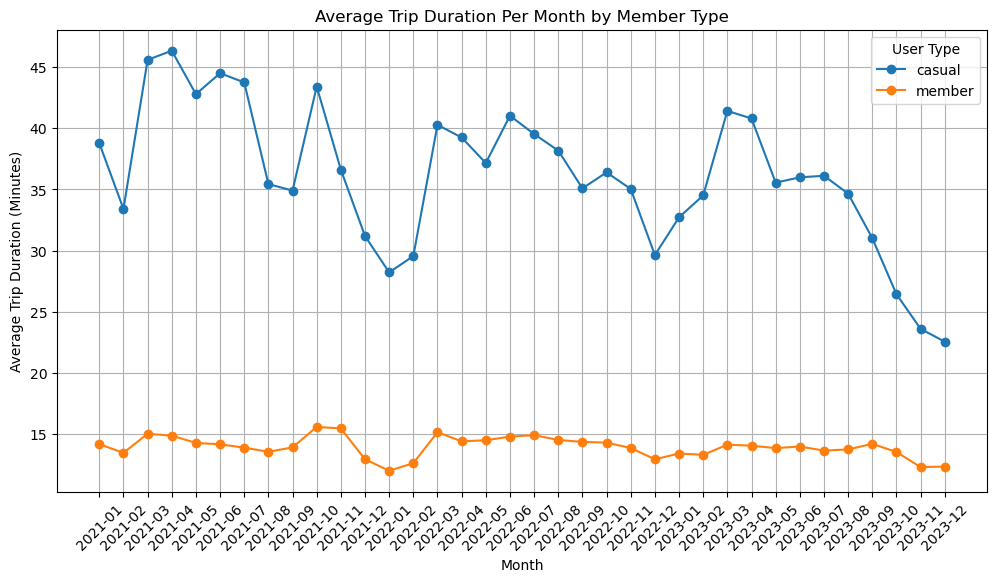

In [28]:
# Calculate trip duration in minutes
bike_master_clean['trip_duration'] = (bike_master_clean['ended_at'] - bike_master_clean['started_at']).dt.total_seconds() / 60

# Resample data by month and member type, then compute the average trip duration
avg_duration_monthly = bike_master_clean.groupby([bike_master_clean['started_at'].dt.to_period('M'), 'member_casual'],observed=False)['trip_duration'].mean().unstack()

# Plot the line graph with months on the x-axis for each member type
plt.figure(figsize=(12, 6))
for member_type in avg_duration_monthly.columns:
    plt.plot(avg_duration_monthly.index.astype(str), avg_duration_monthly[member_type], marker='o', linestyle='-', label=member_type)

plt.xlabel("Month")
plt.ylabel("Average Trip Duration (Minutes)")
plt.title("Average Trip Duration Per Month by Member Type")
plt.xticks(rotation=45)
plt.legend(title="User Type")
plt.grid(True)
plt.show()

In [29]:
#compute the mean latitude and longitude for each station
mean_station_coords = bike_master_clean.groupby('start_station_name', observed=False).agg({'start_lat': 'mean', 'start_lng': 'mean'}).reset_index()

export_csv = mean_station_coords.to_csv('mean_station_coords.csv', index=False)

In [30]:
# Assuming bike_master_clean_2023 is already loaded

# Convert categorical columns to strings for safe comparison
bike_master_clean_2023['start_station_name'] = bike_master_clean_2023['start_station_name'].astype(str)
bike_master_clean_2023['end_station_name'] = bike_master_clean_2023['end_station_name'].astype(str)

# Separate data by member type and filter same-station trips
member_routes = bike_master_clean_2023[
    (bike_master_clean_2023['member_casual'] == 'member') &
    (bike_master_clean_2023['start_station_name'] != bike_master_clean_2023['end_station_name'])
]

casual_routes = bike_master_clean_2023[
    (bike_master_clean_2023['member_casual'] == 'casual') &
    (bike_master_clean_2023['start_station_name'] != bike_master_clean_2023['end_station_name'])
]

# Create route counts
member_route_counts = member_routes.groupby(
    ['start_station_name', 'end_station_name']
).size().reset_index(name='trip_count')

casual_route_counts = casual_routes.groupby(
    ['start_station_name', 'end_station_name']
).size().reset_index(name='trip_count')

# Get top 20 routes
top_member = member_route_counts.sort_values('trip_count', ascending=False).head(20)
top_casual = casual_route_counts.sort_values('trip_count', ascending=False).head(20)

# Print results
print("=== TOP MEMBER ROUTES ===")
print(top_member.to_markdown(index=False, tablefmt="grid"))

print("\n\n=== TOP CASUAL ROUTES ===")
print(top_casual.to_markdown(index=False, tablefmt="grid"))

# Summary statistics
summary = pd.DataFrame({
    'User Type': ['Member', 'Casual'],
    'Total Trips': [len(member_routes), len(casual_routes)],
    'Unique Routes': [member_route_counts.shape[0], casual_route_counts.shape[0]]
})

print("\n=== SUMMARY STATISTICS ===")
print(summary.to_markdown(index=False, tablefmt="grid"))

=== TOP MEMBER ROUTES ===
+-----------------------------------------------------+-----------------------------------------------------+--------------+
| start_station_name                                  | end_station_name                                    |   trip_count |
+=====================================================+=====================================================+==============+
| Columbus Circle / Union Station                     | 8th & F St NE                                       |         2785 |
+-----------------------------------------------------+-----------------------------------------------------+--------------+
| 8th & F St NE                                       | Columbus Circle / Union Station                     |         2428 |
+-----------------------------------------------------+-----------------------------------------------------+--------------+
| Columbus Circle / Union Station                     | 6th & H St NE                              

In [31]:
# For Members
member_routes = bike_master_clean_2023[bike_master_clean_2023['member_casual'] == 'member']
member_route_counts = member_routes.groupby(['start_station_name', 'end_station_name']).size().reset_index(name='trip_count')
top_20_member_routes = member_route_counts.sort_values('trip_count', ascending=False).head(20)

# Add rank column for members
top_20_member_routes.insert(0, 'rank', range(1, 21))

# For Casual Riders
casual_routes = bike_master_clean_2023[bike_master_clean_2023['member_casual'] == 'casual']
casual_route_counts = casual_routes.groupby(['start_station_name', 'end_station_name']).size().reset_index(name='trip_count')
top_20_casual_routes = casual_route_counts.sort_values('trip_count', ascending=False).head(20)

# Add rank column for casual
top_20_casual_routes.insert(0, 'rank', range(1, 21))

# Export to CSV
top_20_member_routes.to_csv('top_20_member_routes.csv', index=False)
top_20_casual_routes.to_csv('top_20_casual_routes.csv', index=False)

# Optional: Export both to a single CSV with a separator between them
# First, add a type column to distinguish between member and casual
top_20_member_routes['rider_type'] = 'member'
top_20_casual_routes['rider_type'] = 'casual'

# Combine both dataframes
combined_routes = pd.concat([top_20_member_routes, top_20_casual_routes])

# Export combined data
combined_routes.to_csv('top_20_all_routes.csv', index=False)

print("Files exported successfully:")
print("1. top_20_member_routes.csv")
print("2. top_20_casual_routes.csv")
print("3. top_20_all_routes.csv")

Files exported successfully:
1. top_20_member_routes.csv
2. top_20_casual_routes.csv
3. top_20_all_routes.csv


In [32]:
# Calculate the mean latitude and longitude for each start station
mean_coords = bike_master_clean_2023.groupby('start_station_name', observed=False)[['start_lat', 'start_lng']].mean().reset_index()

# Sort by the number of occurrences to find the top 10 most frequent start locations
top_10 = bike_master_clean_2023.groupby('start_station_name',observed=False).size().reset_index(name='count')
top_10 = top_10.sort_values(by='count', ascending=False).head(10)

# Merge the mean coordinates with the top 10 locations
top_10_coords = top_10.merge(mean_coords, on='start_station_name')
top_10_coords

# Create a base map centered around the mean coordinates of the top 10 locations
map_center = [top_10_coords['start_lat'].mean(), top_10_coords['start_lng'].mean()]
map = folium.Map(location=map_center, zoom_start=13)

# Add a marker for each of the top 10 locations
for i in range(top_10_coords.shape[0]):
    row = top_10_coords.iloc[i]
    folium.Marker(
        location=[row['start_lat'], row['start_lng']],
        popup=row['start_station_name'],
        icon=folium.Icon(color='blue', icon='bicycle', prefix='fa')
    ).add_to(map)   
map


**Most Popular Rides**

In [33]:
# Count occurrences of each start station and get the top 10
top_10_start = bike_master_clean_2023['start_station_name'].value_counts().head(10).reset_index()
top_10_start.columns = ['start_station_name', 'start_count']

# Filter for the top 10 start stations
top_10_routes = bike_master_clean_2023[bike_master_clean_2023['start_station_name'].isin(top_10_start['start_station_name'])]

# Count how often each end station appears for these top 10 start stations
popular_routes = top_10_routes.groupby(['start_station_name', 'end_station_name'], observed=False).size().reset_index(name='route_count')

# Sort by start station and route popularity
popular_routes = popular_routes.sort_values(by=['start_station_name', 'route_count'], ascending=[True, False])

# Find the most common start-end pairs
top_routes_summary = bike_master_clean_2023.groupby(['start_station_name', 'end_station_name'],observed=False).size().reset_index(name='count')

# Sort by popularity
top_routes_summary = top_routes_summary.sort_values(by='count', ascending=False).head(10)

print(top_routes_summary.head(10))



                                       start_station_name  \
94232                           Jefferson Dr & 14th St SW   
126996  Smithsonian-National Mall / Jefferson Dr & 12t...   
76343                     Columbus Circle / Union Station   
91109                                      Gravelly Point   
62088                                       8th & F St NE   
99863                                    Lincoln Memorial   
55186                              4th St & Madison Dr NW   
76328                     Columbus Circle / Union Station   
93046         Henry Bacon Dr & Lincoln Memorial Circle NW   
116237   Ohio Dr & West Basin Dr SW / MLK & FDR Memorials   

                                         end_station_name  count  
94232                           Jefferson Dr & 14th St SW   4521  
126996  Smithsonian-National Mall / Jefferson Dr & 12t...   4140  
76343                                       8th & F St NE   3610  
91109                                      Gravelly Point   

In [35]:
# Create a map centered around the data
map_center = [bike_master_clean_2023['start_lat'].mean(), bike_master_clean_2023['start_lng'].mean()]
heat_map = folium.Map(location=map_center, zoom_start=12)

# Prepare start and end locations with counts
start_locations = bike_master_clean_2023.groupby(['start_lat', 'start_lng']).size().reset_index()
start_locations.columns = ['lat', 'lng', 'count']

end_locations = bike_master_clean_2023.groupby(['end_lat', 'end_lng']).size().reset_index()
end_locations.columns = ['lat', 'lng', 'count']

# Combine start and end locations
all_locations = pd.concat([start_locations, end_locations])

# Filter out rows with NaN values and convert to list of lists
heat_data = all_locations.dropna(subset=['lat', 'lng']).astype(float).values.tolist()

# Add the heatmap layer
HeatMap(
    data=heat_data,
    radius=8,
    max_zoom=13,
    min_opacity=0.5,
    blur=5
).add_to(heat_map)

# Display the map
heat_map


In [37]:
#find the unique start station name and end station name
start_station_name = bike_master_clean_2023['start_station_name'].unique()
end_station_name = bike_master_clean_2023['end_station_name'].unique()

#convert numpy arrays to pandas Series
start_station_name_series = pd.Series(start_station_name, name='start_station_name')
end_station_name_series = pd.Series(end_station_name, name='end_station_name')

#export as csv
start_station_name_series.to_csv('start_station_name.csv', index=False)
end_station_name_series.to_csv('end_station_name.csv', index=False)

In [38]:
# Read the original station data
df = pd.read_csv('mean_station_coords.csv')

# Function to categorize stations
def categorize_station_location(lat, lng):
    regions = {
        'Washington DC': {
            'lat': (38.8, 39.0),
            'lng': (-77.12, -76.9)
        },
        'Arlington': {
            'lat': (38.8, 38.93),
            'lng': (-77.17, -77.03)
        },
        'Alexandria': {
            'lat': (38.77, 38.85),
            'lng': (-77.15, -77.03)
        },
        'Montgomery County': {
            'lat': (38.95, 39.2),
            'lng': (-77.3, -76.9)
        },
        "Prince George's County": {
            'lat': (38.8, 39.1),
            'lng': (-76.95, -76.7)
        },
        'Fairfax County': {
            'lat': (38.7, 39.0),
            'lng': (-77.4, -77.15)
        }
    }
    
    for region, bounds in regions.items():
        if (bounds['lat'][0] <= lat <= bounds['lat'][1] and 
            bounds['lng'][0] <= lng <= bounds['lng'][1]):
            return region
    return 'Other'

# Add region column to the dataframe
df['region'] = df.apply(lambda row: categorize_station_location(
    row['start_lat'], 
    row['start_lng']
), axis=1)

# Export to CSV
df.to_csv('categorized_stations.csv', index=False)

# Display summary statistics
print("\nStation counts by region:")
print(df['region'].value_counts())

# Display percentage distribution
print("\nPercentage distribution by region:")
print(df['region'].value_counts(normalize=True) * 100)


Station counts by region:
region
Washington DC             663
Fairfax County            110
Montgomery County          56
Arlington                  17
Prince George's County      5
Other                       5
Alexandria                  4
Name: count, dtype: int64

Percentage distribution by region:
region
Washington DC             77.093023
Fairfax County            12.790698
Montgomery County          6.511628
Arlington                  1.976744
Prince George's County     0.581395
Other                      0.581395
Alexandria                 0.465116
Name: proportion, dtype: float64


In [39]:
# Function to categorize stations
def categorize_station_location(lat, lng):
    regions = {
        'Washington DC': {'lat': (38.8, 39.0), 'lng': (-77.12, -76.9)},
        'Arlington': {'lat': (38.8, 38.93), 'lng': (-77.17, -77.03)},
        'Alexandria': {'lat': (38.77, 38.85), 'lng': (-77.15, -77.03)},
        'Montgomery County': {'lat': (38.95, 39.2), 'lng': (-77.3, -76.9)},
        "Prince George's County": {'lat': (38.8, 39.1), 'lng': (-76.95, -76.7)},
        'Fairfax County': {'lat': (38.7, 39.0), 'lng': (-77.4, -77.15)}
    }
    
    for region, bounds in regions.items():
        if (bounds['lat'][0] <= lat <= bounds['lat'][1] and 
            bounds['lng'][0] <= lng <= bounds['lng'][1]):
            return region
    return 'Other'

# Apply function to classify each start station
bike_master_clean_2023['region'] = bike_master_clean_2023.apply(lambda row: categorize_station_location(row['start_lat'], row['start_lng']), axis=1)

In [40]:
#Count of trips by region
region_trips = bike_master_clean_2023['region'].value_counts()
region_trips


region
Washington DC             3798359
Fairfax County              27232
Montgomery County           14668
Arlington                   12925
Alexandria                   6513
Other                        4198
Prince George's County        888
Name: count, dtype: int64

In [41]:
#aggregate the number of trips by region
region_trips = bike_master_clean_2023.groupby('region', observed=False).agg({'start_lat':'mean', 'start_lng':'mean', 'ride_id':'count'}).reset_index()
region_trips.rename(columns={'ride_id': 'trip_count'}, inplace=True)

# Create a Folium map centered around Washington, DC
m = folium.Map(location=[38.9, -77.05], zoom_start=10)

# Create a Marker Cluster
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each region (including Washington DC)
for _, row in region_trips.iterrows():
    folium.Marker(
        location=[row['start_lat'], row['start_lng']], 
        popup=f"{row['region']}: {row['trip_count']} trips",
        icon=folium.Icon(color="blue", icon="info-sign")  # Adjust colors if needed
    ).add_to(marker_cluster)

# Display the map
m


#KPIs   

In [42]:
#Average Ride Duration: Monthly and by User Type , Helps in understanding the typical ride length and optimizing pricing or availability.
avg_duration_monthly = bike_master_clean_2023.groupby([bike_master_clean_2023['started_at'].dt.to_period('M'), 'member_casual'],observed=False)['duration'].mean().unstack()
avg_duration_monthly

member_casual,casual,member
started_at,,
2023-01,26.989611,12.571902
2023-02,27.378622,12.545660
2023-03,32.619319,13.069916
2023-04,33.020209,13.273708
2023-05,30.625691,13.276251
2023-06,29.133049,13.208475
2023-07,29.628909,12.939254
2023-08,28.691298,13.071210
2023-09,26.129527,13.073918


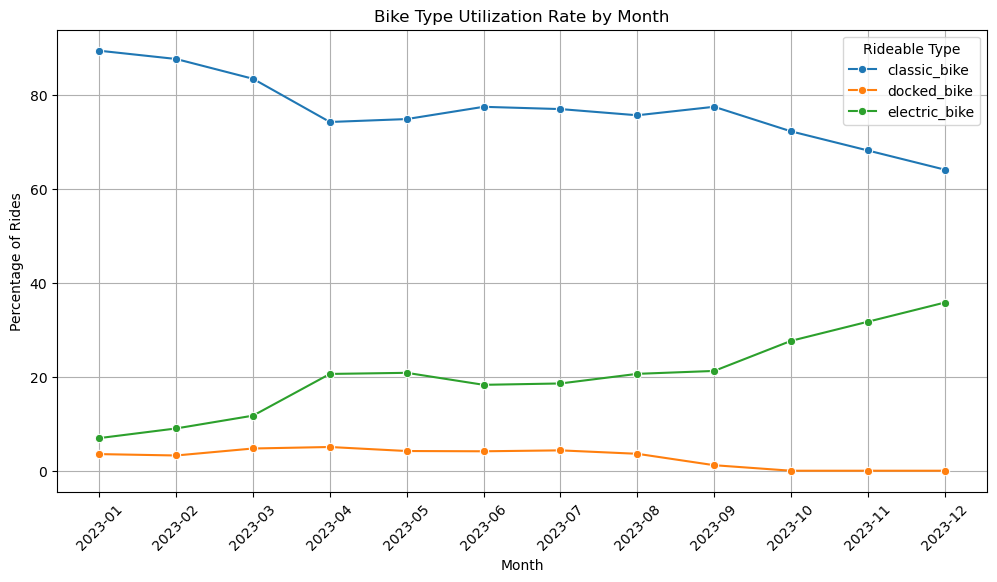

In [43]:
#Bike Type Utilization Rate in percentage by  Monthly and by User Type, Helps in understanding the popularity of different bike types and optimizing inventory.

#count the ride per rideable type and month
rideable_type_monthly = bike_master_clean_2023.groupby(['month_year', 'rideable_type'], observed=False).agg(trip_count=('ride_id', 'count')).reset_index()

#calculate the total number of rides per month
total_rides = rideable_type_monthly.groupby('month_year', observed=False).agg(total_rides=('trip_count', 'sum')).reset_index()

# Merge total rides with bike type counts
rideable_type_monthly = rideable_type_monthly.merge(total_rides, on='month_year', how='left')

# Calculate percentage of rides per bike type
rideable_type_monthly['percentage'] = (rideable_type_monthly['trip_count'] / rideable_type_monthly['total_rides']) * 100

# Convert month_year to string for plotting
rideable_type_monthly['month_year'] = rideable_type_monthly['month_year'].astype(str)

#plot the percentage of rides per bike type
plt.figure(figsize=(12, 6))
sns.lineplot(data=rideable_type_monthly, x='month_year', y='percentage', hue='rideable_type', marker='o')
plt.title("Bike Type Utilization Rate by Month")
plt.xlabel("Month")
plt.ylabel("Percentage of Rides")
plt.xticks(rotation=45)
plt.legend(title="Rideable Type")
plt.grid(True)
plt.show()




In [44]:
# Function to categorize station location based on lat/lng
def categorize_station_location(lat, lng):
    regions = {
        'Washington DC': {'lat': (38.8, 39.0), 'lng': (-77.12, -76.9)},
        'Arlington': {'lat': (38.8, 38.93), 'lng': (-77.17, -77.03)},
        'Alexandria': {'lat': (38.77, 38.85), 'lng': (-77.15, -77.03)},
        'Montgomery County': {'lat': (38.95, 39.2), 'lng': (-77.3, -76.9)},
        "Prince George's County": {'lat': (38.8, 39.1), 'lng': (-76.95, -76.7)},
        'Fairfax County': {'lat': (38.7, 39.0), 'lng': (-77.4, -77.15)}
    }
    
    for region, bounds in regions.items():
        if bounds['lat'][0] <= lat <= bounds['lat'][1] and bounds['lng'][0] <= lng <= bounds['lng'][1]:
            return region
    return 'Other'

# Assign regions to start and end locations
bike_master_clean_2023['start_region'] = bike_master_clean_2023.apply(lambda row: categorize_station_location(row['start_lat'], row['start_lng']), axis=1)
bike_master_clean_2023['end_region'] = bike_master_clean_2023.apply(lambda row: categorize_station_location(row['end_lat'], row['end_lng']), axis=1)

# Count trips per region
start_region_counts = bike_master_clean_2023.groupby('start_region').size().reset_index(name='count')
end_region_counts = bike_master_clean_2023.groupby('end_region').size().reset_index(name='count')

# Combine start and end trip counts
region_counts = pd.concat([start_region_counts, end_region_counts]).groupby('start_region').sum().reset_index()

# Define approximate center points for each region
region_centers = {
    'Washington DC': [38.9, -77.03],
    'Arlington': [38.88, -77.1],
    'Alexandria': [38.82, -77.1],
    'Montgomery County': [39.1, -77.05],
    "Prince George's County": [38.95, -76.85],
    'Fairfax County': [38.85, -77.3],
    'Other': [38.9, -77.04]  # Default center
}

# Map region names to their approximate coordinates
region_counts['lat'] = region_counts['start_region'].map(lambda x: region_centers.get(x, [38.9, -77.04])[0])
region_counts['lng'] = region_counts['start_region'].map(lambda x: region_centers.get(x, [38.9, -77.04])[1])

# Create a map centered around the city
map_center = [38.9, -77.04]  # Adjust as needed
heat_map = folium.Map(location=map_center, zoom_start=11)

# Prepare heatmap data
heat_data = region_counts[['lat', 'lng', 'count']].dropna().values.tolist()

# Add the heatmap layer
HeatMap(
    data=heat_data,
    radius=30,  # Adjust radius to make the heatmap region-focused
    max_zoom=13,
    min_opacity=0.5,
    blur=20
).add_to(heat_map)

# Display the map
heat_map

In [45]:
import folium
import pandas as pd

# Find the top 10 stations with the highest number of trips in 2023
top_stations_2023 = (
    bike_master_clean_2023
    .groupby('start_station_name', observed=False)
    .agg(trip_count=('ride_id', 'count'))
    .nlargest(10, 'trip_count')
    .reset_index()
)

# Merge with stations dataframe to get latitude and longitude
top_stations_2023 = top_stations_2023.merge(stations, left_on='start_station_name', right_on='station')

# Compute the map center based on mean latitude and longitude
map_center = [top_stations_2023['lat'].mean(), top_stations_2023['lng'].mean()]
top_stations_map = folium.Map(location=map_center, zoom_start=12)

# Add GeoJSON layers
folium.GeoJson("Neighborhood_Planning_Areas.geojson", name="Neighborhood").add_to(top_stations_map)
folium.GeoJson("Wards_from_2012.geojson", name="Wards").add_to(top_stations_map)
folium.GeoJson("Capital_Bikeshare_Locations.geojson", name="Capital_Bike_Share").add_to(top_stations_map)
folium.GeoJson("Metro_Bus_Lines.geojson", name="Bus_route").add_to(top_stations_map)


# Add markers for the top 10 stations
for _, row in top_stations_2023.iterrows():
    folium.Marker(
        location=[row['lat'], row['lng']],
        popup=folium.Popup(f"{row['start_station_name']} ({row['trip_count']} trips)", max_width=250),
        icon=folium.Icon(color='blue', icon='bicycle', prefix='fa')
    ).add_to(top_stations_map)

# Add layer control for toggling layers
folium.LayerControl().add_to(top_stations_map)

# Display map
top_stations_map

In [46]:
#computing the trip duration
bike_master_clean_2023['trip_duration'] = (bike_master_clean_2023['ended_at'] - bike_master_clean_2023['started_at']).dt.total_seconds() / 60

#Identify Outliers Using Statistical Methods
#Method 1: IQR (Interquartile Range)
Q1 = bike_master_clean_2023['trip_duration'].quantile(0.25)
Q3 = bike_master_clean_2023['trip_duration'].quantile(0.75)
IQR = Q3 - Q1

# Filter out outliers
outliers_iqr = bike_master_clean_2023[(bike_master_clean_2023['trip_duration'] < (Q1 - 1.5 * IQR)) | (bike_master_clean_2023['trip_duration'] > (Q3 + 1.5 * IQR))]
outliers_iqr

#count the number of outliers
num_outliers_iqr = outliers_iqr.shape[0]
num_outliers_iqr

#count the number of outliers by member type
outliers_iqr_member = outliers_iqr['member_casual'].value_counts()
outliers_iqr_member

#exclude the outliers from the dataset using the IQR method 
bike_master_clean_no_outliers_iqr = bike_master_clean_2023[(bike_master_clean_2023['trip_duration'] >= (Q1 - 1.5 * IQR)) & (bike_master_clean_2023['trip_duration'] <= (Q3 + 1.5 * IQR))]


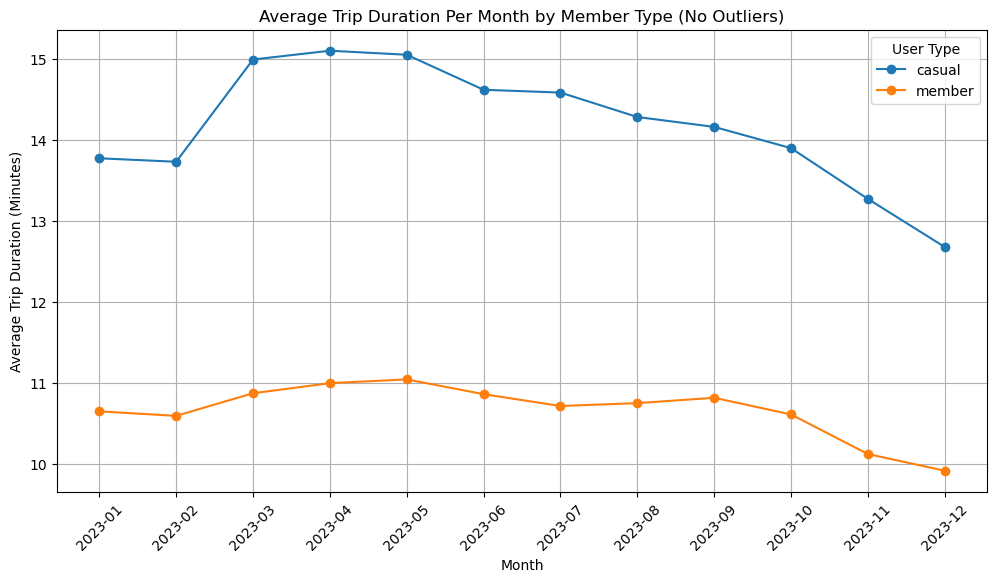

In [47]:
#plot the average ride duration by month and user type using the cleaned dataset
avg_duration_monthly_clean = bike_master_clean_no_outliers_iqr.groupby([bike_master_clean_no_outliers_iqr['started_at'].dt.to_period('M'), 'member_casual'],observed=False)['trip_duration'].mean().unstack()

# Plot the line graph with months on the x-axis for each member type
plt.figure(figsize=(12, 6))
for member_type in avg_duration_monthly_clean.columns:
    plt.plot(avg_duration_monthly_clean.index.astype(str), avg_duration_monthly_clean[member_type], marker='o', linestyle='-', label=member_type)

plt.xlabel("Month")
plt.ylabel("Average Trip Duration (Minutes)")
plt.title("Average Trip Duration Per Month by Member Type (No Outliers)")
plt.xticks(rotation=45)
plt.legend(title="User Type")
plt.grid(True)
plt.show()



In [48]:
#importing new csv file
bus_stations = pd.read_csv('Metro_Bus_Stops.csv') # Metro bus stations
bike_stations = pd.read_csv('Capital_Bikeshare_Locations.csv')  # Capital Bikeshare stations

#change the header name to lowercase and remove spaces
bus_stations.columns = bus_stations.columns.str.lower().str.replace(' ', '_')
bike_stations.columns = bike_stations.columns.str.lower().str.replace(' ', '_')



In [97]:
# Convert 'started_at' to date only
bike_master_clean_2023['date'] = bike_master_clean_2023['started_at'].dt.date

# Specify the date for which you want to calculate departures (convert to date type)
specific_date = pd.to_datetime('2023-02-03').date()

# Filter the dataset for the specific date
filtered_data = bike_master_clean_2023[bike_master_clean_2023['date'] == specific_date]

# Ensure num_bikes_available is numeric
bike_stations['num_bikes_available'] = pd.to_numeric(bike_stations['num_bikes_available'], errors='coerce')

# Count trips per start station using trip ID
trip_count = filtered_data.groupby('start_station_name')['ride_id'].count().reset_index()

# Rename the column for clarity
trip_count.rename(columns={'ride_id': 'trip_count'}, inplace=True)

# Merge with the station data
station_departure = trip_count.merge(bike_stations, left_on='start_station_name', right_on='name')

# Calculate the utilization rate of the stations
station_departure['utilization_rate'] = station_departure['trip_count'] / station_departure['num_bikes_available']

# Display the top 10 stations with the highest utilization rate
top_10_departure = station_departure.nlargest(10, 'utilization_rate')
top_10_departure

# Show only station name, trip count, and utilization rate
top_10_departure = top_10_departure[['start_station_name', 'latitude', 'longitude', 'trip_count', 'num_bikes_available', 'utilization_rate']]   
top_10_departure

# Create a base map centered around Washington, D.C.
m = folium.Map(location=[38.9072, -77.0369], zoom_start=12)

# Define color categories based on utilization rate
def get_marker_color(utilization_rate):
    if utilization_rate == float('inf'):  # Critical places with no available bikes
        return 'red'
    elif utilization_rate > 5:  # High utilization
        return 'orange'
    elif utilization_rate > 1:  # Moderate utilization
        return 'blue'
    else:  # Underutilized
        return 'green'

# Create a marker cluster for better visualization
marker_cluster = MarkerCluster().add_to(m)

# Iterate over the data to add markers
for index, row in station_departure.iterrows():
    lat, lng = row['latitude'], row['longitude']
    station_name = row['start_station_name']
    trip_count_val = row['trip_count']
    num_bikes = row['num_bikes_available']
    utilization = row['utilization_rate']
    color = get_marker_color(utilization)

    popup_text = f"""
    <b>{station_name}</b><br>
    Trips: {trip_count_val}<br>
    Bikes Available: {num_bikes}<br>
    Utilization Rate: {utilization}
    """
    
    folium.Marker(
        location=[lat, lng],
        popup=popup_text,
        icon=folium.Icon(color=color)
    ).add_to(marker_cluster)

m
